In [1]:
# Copyright (c) 2022 Oracle and/or its affiliates.

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import json
import cx_Oracle
import os
import pandas as pd
import yaml
wallet_location = '/home/ubuntu/wallets/forzaf1'

os.environ['TNS_ADMIN'] = wallet_location

!echo $TNS_ADMIN

/home/ubuntu/wallets/forzaf1


In [2]:
os.environ['PATH']='/home/ubuntu/miniconda3/bin:$PATH'

In [3]:
!python -m pip install -U pip
!python -m pip install -U setuptools wheel
!python -m pip install -U "mxnet<2.0.0"
!python -m pip install autogluon
!pip install dataprep
!pip install dask
!pip install pandas_profiling
## install packages
!pip install -q scikit-learn
!pip install ipywidgets
!pip install sweetviz
!pip install Autoviz
!pip install xlrd

  Using cached dataprep-0.4.1-py3-none-any.whl (3.5 MB)
  Using cached aiohttp-3.8.1-cp37-cp37m-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_12_x86_64.manylinux2010_x86_64.whl (1.1 MB)
  Using cached jsonpath_ng-1.5.3-py3-none-any.whl (29 kB)
  Using cached Flask_Cors-3.0.10-py2.py3-none-any.whl (14 kB)
  Using cached Jinja2-2.11.3-py2.py3-none-any.whl (125 kB)
  Using cached Bottleneck-1.3.2.tar.gz (88 kB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached levenshtein-0.12.0-cp37-cp37m-manylinux1_x86_64.whl (158 kB)
  Using cached bokeh-2.4.2-py3-none-any.whl (18.5 MB)
  Using cached usaddress-0.5.10-py2.py3-none-any.whl (63 kB)
  Using cached Metaphone-0.6-py3-none-any.whl
  Using cached dask-2.30.0-py3-none-any.whl (848 kB)
  Using cached Flask-1.1.4-py2.py3-none-any.whl (94 kB)
  Using cached regex-2020.11.13-cp37-cp37m-manylinux2014_x86_64.whl (719 kB)
  Using cached python_std

In [4]:
def process_yaml():
	with open("formulahack.yaml") as file:
		return yaml.safe_load(file)

class OracleATPDatabaseConnection:
    def __init__(self, data=process_yaml()):
        # wallet location (default is HOME/wallets/wallet_X)
        print(os.environ['TNS_ADMIN'])
        self.pool = cx_Oracle.SessionPool(data['db']['username'], data['db']['password'], data['db']['dsn'],
            min=1, max=4, increment=1, threaded=True,
            getmode=cx_Oracle.SPOOL_ATTRVAL_WAIT
        )
        print('Connection successful.')



    def close_pool(self):
        self.pool.close()
        print('Connection pool closed.')



    def insert(self, cursor_object):
        connection = self.pool.acquire()
        connection.autocommit = True
        cursor = connection.cursor()

        try:
            # print(sql_insert)
            cursor.execute(cursor_object)
            print('[DBG] INSERT {} OK'.format(cursor_object))
        except Exception as e:
            print('[DBG] INSERT ERR: {}'.format(e))

        self.pool.release(connection)
        return 1


    # select
    def select(self, query_sql):
        assert 'select' in query_sql.lower()
        connection = self.pool.acquire()
        connection.autocommit = True
        cursor = connection.cursor()
        return_list = list()
        try:
            cursor.execute(query_sql)
            print('[DBG] SELECT OK')
        except Exception as e:
            print('[DBG] SELECT ERR {}'.format(e))

        rows = cursor.fetchall()
        if rows:
            for x in rows:
                return_list.append(x)
        self.pool.release(connection)
        return return_list


    # update
    def update(self, query_sql, row, debug=None):
        assert 'update' in query_sql.lower()
        connection = self.pool.acquire()
        connection.autocommit = True
        cursor = connection.cursor()
        try:
            cursor.execute(query_sql, row)
            if debug:
                print('[DBG][{}] UPDATE {} OK'.format(debug, row))
            else:
                print('[DBG] UPDATE {} OK'.format(row))
        except Exception as e:
            if debug:  
                print('[DBG][{}] UPDATE ERR {}'.format(debug, e))
            else:
                print('[DBG] UPDATE ERR {}'.format(e))

        self.pool.release(connection)
        return 1
    

    def get_connection(self):
        connection = self.pool.acquire()
        connection.autocommit = True
        return connection

In [5]:
atp = OracleATPDatabaseConnection()

/home/ubuntu/wallets/forzaf1
Connection successful.


In [6]:
query = 'SELECT * from admin.f1_2021_weather_view'
data_test = pd.read_sql(query, con=atp.get_connection())
data_test.head(5)

,M_WEATHER_FORECAST_SAMPLES_M_SESSION_TYPE,M_TIME_OFFSET,M_WEATHER_FORECAST_SAMPLES_M_WEATHER,M_TRACK_TEMPERATURE_CHANGE,TIMESTAMP,M_TRACK_TEMPERATURE,M_GAME_PAUSED,M_FORECAST_ACCURACY,M_AIR_TEMPERATURE,M_NUM_WEATHER_FORECAST_SAMPLES,...,M_WEATHER,M_AI_DIFFICULTY,M_PIT_SPEED_LIMIT,M_NETWORK_GAME,M_TOTAL_LAPS,M_STEERING_ASSIST,M_IS_SPECTATING,M_DYNAMIC_RACING_LINE,M_DRSASSIST,M_NUM_MARSHAL_ZONES
0,10,0,0,2,1.641647e+09,31,0,0,23,3,...,0,31,60,0,5,0,0,2,1,17
1,10,5,0,1,1.641647e+09,31,0,0,23,3,...,0,31,60,0,5,0,0,2,1,17
2,10,10,0,2,1.641647e+09,31,0,0,23,3,...,0,31,60,0,5,0,0,2,1,17
3,0,0,0,0,1.641647e+09,31,0,0,23,3,...,0,31,60,0,5,0,0,2,1,17
4,0,0,0,0,1.641647e+09,31,0,0,23,3,...,0,31,60,0,5,0,0,2,1,17


In [7]:
print(len(data_test))

8045296


In [8]:
query = 'SELECT * from admin.f1_2021_weather_view_full'
data_test = pd.read_sql(query, con=atp.get_connection())
data_test.head(5)

,M_PACKET_FORMAT,M_GAME_MAJOR_VERSION,M_GAME_MINOR_VERSION,M_PACKET_VERSION,M_PACKET_ID,M_SESSION_UID,M_SESSION_TIME,M_FRAME_IDENTIFIER,M_PLAYER_CAR_INDEX,M_SECONDARY_PLAYER_CAR_INDEX,...,M_WEATHER,M_AI_DIFFICULTY,M_PIT_SPEED_LIMIT,M_NETWORK_GAME,M_TOTAL_LAPS,M_STEERING_ASSIST,M_IS_SPECTATING,M_DYNAMIC_RACING_LINE,M_DRSASSIST,M_NUM_MARSHAL_ZONES
0,2021,1,14,1,1,1391867972949549067,375.199,9674,19,255,...,0,31,60,0,5,0,0,2,1,17
1,2021,1,14,1,1,1391867972949549067,375.199,9674,19,255,...,0,31,60,0,5,0,0,2,1,17
2,2021,1,14,1,1,1391867972949549067,375.199,9674,19,255,...,0,31,60,0,5,0,0,2,1,17
3,2021,1,14,1,1,1391867972949549067,375.199,9674,19,255,...,0,31,60,0,5,0,0,2,1,17
4,2021,1,14,1,1,1391867972949549067,375.199,9674,19,255,...,0,31,60,0,5,0,0,2,1,17


In [9]:
data_test.describe()

,M_PACKET_FORMAT,M_GAME_MAJOR_VERSION,M_GAME_MINOR_VERSION,M_PACKET_VERSION,M_PACKET_ID,M_SESSION_UID,M_SESSION_TIME,M_FRAME_IDENTIFIER,M_PLAYER_CAR_INDEX,M_SECONDARY_PLAYER_CAR_INDEX,...,M_WEATHER,M_AI_DIFFICULTY,M_PIT_SPEED_LIMIT,M_NETWORK_GAME,M_TOTAL_LAPS,M_STEERING_ASSIST,M_IS_SPECTATING,M_DYNAMIC_RACING_LINE,M_DRSASSIST,M_NUM_MARSHAL_ZONES
count,11062282.0,11062282.0,11062282.0,11062282.0,11062282.0,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07,11062282.0,...,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07,1.106228e+07
mean,2021.0,1.0,14.0,1.0,1.0,8.651187e+18,8.788952e+02,2.620749e+04,1.342989e+01,255.0,...,2.679131e-01,6.490188e+01,7.891707e+01,2.870965e-01,1.658906e+02,1.045898e-01,1.326688e-02,3.826375e-01,1.913188e-01,1.631444e+01
std,0.0,0.0,0.0,0.0,0.0,5.215626e+18,1.574334e+03,5.209130e+04,2.188733e+01,0.0,...,6.309880e-01,3.866394e+01,4.526128e+00,4.524070e-01,6.990585e+01,3.060242e-01,1.144154e-01,7.866788e-01,3.933394e-01,9.749482e-01
min,2021.0,1.0,14.0,1.0,1.0,3.168741e+15,4.000000e-03,0.000000e+00,0.000000e+00,255.0,...,0.000000e+00,0.000000e+00,6.000000e+01,0.000000e+00,5.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+01
25%,2021.0,1.0,14.0,1.0,1.0,3.745645e+18,6.885900e+01,1.902000e+03,1.000000e+00,255.0,...,0.000000e+00,3.100000e+01,8.000000e+01,0.000000e+00,2.000000e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.600000e+01
50%,2021.0,1.0,14.0,1.0,1.0,8.818562e+18,2.847565e+02,7.855000e+03,1.900000e+01,255.0,...,0.000000e+00,9.000000e+01,8.000000e+01,0.000000e+00,2.000000e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.600000e+01
75%,2021.0,1.0,14.0,1.0,1.0,1.317187e+19,8.815410e+02,2.601600e+04,1.900000e+01,255.0,...,0.000000e+00,9.000000e+01,8.000000e+01,1.000000e+00,2.000000e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.700000e+01
max,2021.0,1.0,14.0,1.0,1.0,1.835659e+19,9.783061e+03,3.362990e+05,2.550000e+02,255.0,...,5.000000e+00,1.100000e+02,8.000000e+01,1.000000e+00,2.000000e+02,1.000000e+00,1.000000e+00,2.000000e+00,1.000000e+00,2.000000e+01


In [10]:
print(data_test.columns)

Index(['M_PACKET_FORMAT', 'M_GAME_MAJOR_VERSION', 'M_GAME_MINOR_VERSION',
       'M_PACKET_VERSION', 'M_PACKET_ID', 'M_SESSION_UID', 'M_SESSION_TIME',
       'M_FRAME_IDENTIFIER', 'M_PLAYER_CAR_INDEX',
       'M_SECONDARY_PLAYER_CAR_INDEX', 'M_BRAKING_ASSIST',
       'M_SESSION_LINK_IDENTIFIER', 'M_PIT_RELEASE_ASSIST', 'TIMESTAMP',
       'M_ZONE_START', 'M_ZONE_FLAG', 'M_PIT_STOP_WINDOW_IDEAL_LAP',
       'M_TRACK_TEMPERATURE', 'M_TRACK_LENGTH', 'M_GAME_PAUSED',
       'M_FORECAST_ACCURACY', 'GAMEHOST', 'M_AIR_TEMPERATURE',
       'M_NUM_WEATHER_FORECAST_SAMPLES', 'M_SLI_PRO_NATIVE_SUPPORT',
       'M_SAFETY_CAR_STATUS', 'M_TRACK_ID', 'M_ERSASSIST', 'M_FORMULA',
       'M_SEASON_LINK_IDENTIFIER', 'M_PIT_ASSIST', 'M_GEARBOX_ASSIST',
       'M_SESSION_TYPE', 'M_SPECTATOR_CAR_INDEX',
       'M_PIT_STOP_WINDOW_LATEST_LAP', 'M_WEEKEND_LINK_IDENTIFIER',
       'M_DYNAMIC_RACING_LINE_TYPE', 'M_SESSION_TIME_LEFT',
       'M_SESSION_DURATION', 'M_PIT_STOP_REJOIN_POSITION',
       'M_WEATHER_FO

In [11]:
print(len(data_test))

11062282


In [12]:
import sweetviz as sv

#feature_config = sv.FeatureConfig(force_num=["M_WEATHER"]) # label
feature_config = sv.FeatureConfig(force_num=['M_PACKET_FORMAT', 'M_GAME_MAJOR_VERSION', 'M_GAME_MINOR_VERSION',
       'M_PACKET_VERSION', 'M_PACKET_ID', 'M_SESSION_UID', 'M_SESSION_TIME',
       'M_FRAME_IDENTIFIER', 'M_PLAYER_CAR_INDEX',
       'M_SECONDARY_PLAYER_CAR_INDEX', 'M_BRAKING_ASSIST',
       'M_SESSION_LINK_IDENTIFIER', 'M_PIT_RELEASE_ASSIST', 'TIMESTAMP',
       'M_ZONE_START', 'M_ZONE_FLAG', 'M_PIT_STOP_WINDOW_IDEAL_LAP',
       'M_TRACK_TEMPERATURE', 'M_TRACK_LENGTH', 'M_GAME_PAUSED',
       'M_FORECAST_ACCURACY', 'M_AIR_TEMPERATURE',
       'M_NUM_WEATHER_FORECAST_SAMPLES', 'M_SLI_PRO_NATIVE_SUPPORT',
       'M_SAFETY_CAR_STATUS', 'M_TRACK_ID', 'M_ERSASSIST', 'M_FORMULA',
       'M_SEASON_LINK_IDENTIFIER', 'M_PIT_ASSIST', 'M_GEARBOX_ASSIST',
       'M_SESSION_TYPE', 'M_SPECTATOR_CAR_INDEX',
       'M_PIT_STOP_WINDOW_LATEST_LAP', 'M_WEEKEND_LINK_IDENTIFIER',
       'M_DYNAMIC_RACING_LINE_TYPE', 'M_SESSION_TIME_LEFT',
       'M_SESSION_DURATION', 'M_PIT_STOP_REJOIN_POSITION',
       'M_WEATHER_FORECAST_SAMPLES_M_SESSION_TYPE', 'M_TIME_OFFSET',
       'M_WEATHER_FORECAST_SAMPLES_M_WEATHER',
       'M_WEATHER_FORECAST_SAMPLES_M_TRACK_TEMPERATURE',
       'M_TRACK_TEMPERATURE_CHANGE',
       'M_WEATHER_FORECAST_SAMPLES_M_AIR_TEMPERATURE',
       'M_AIR_TEMPERATURE_CHANGE', 'M_RAIN_PERCENTAGE', 'M_WEATHER',
       'M_AI_DIFFICULTY', 'M_PIT_SPEED_LIMIT', 'M_NETWORK_GAME',
       'M_TOTAL_LAPS', 'M_STEERING_ASSIST', 'M_IS_SPECTATING',
       'M_DYNAMIC_RACING_LINE', 'M_DRSASSIST', 'M_NUM_MARSHAL_ZONES'])


Alert! from autoviz version 0.1.35, after importing, you must %matplotlib inline to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
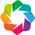

    Since nrows is smaller than dataset, loading random sample of 150000 rows into pandas...
Shape of your Data Set loaded: (150000, 58)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  12
    Number of Integer-Categorical Columns =  22
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  1
    Number of Numeric-Boolean Columns =  15
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  7
    57 Predictors classified...
        7 variables removed since they were ID or low-information variables
    List of variables removed: ['M_PACKET_FORMAT', 'M_GAME_MAJOR_VERSION', 'M_GAME_MINOR_VERSION', 'M_PACKET_VERSION', 'M_PACKET_ID', 'M_SECONDARY_PLAYER_CAR_INDEX', 'M_SLI_PRO_NATIVE_SUPPORT']

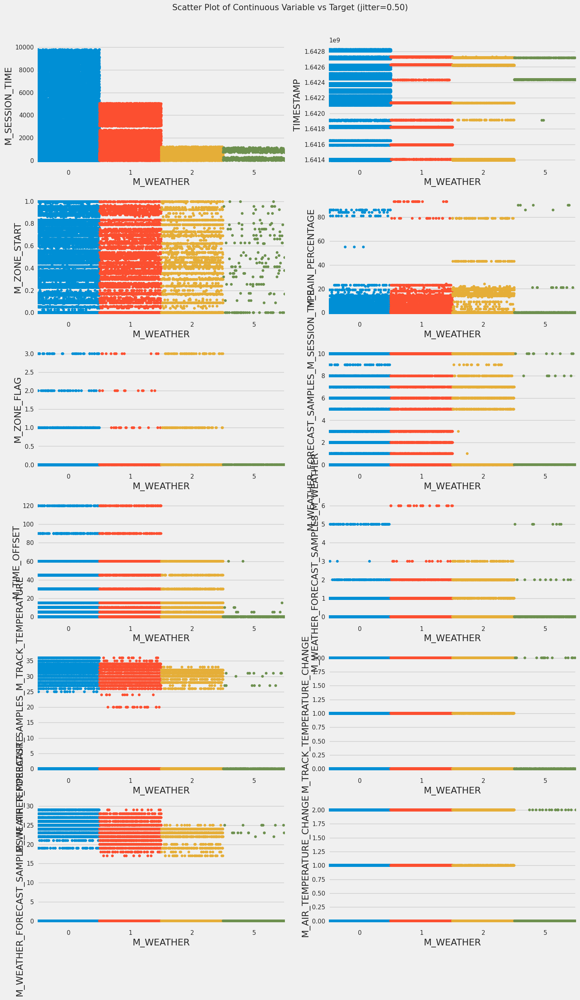

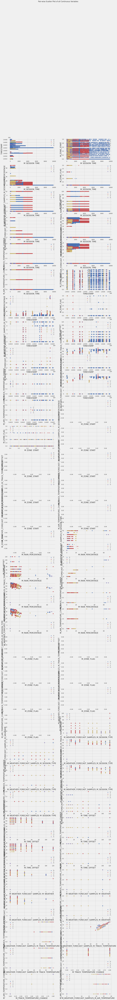

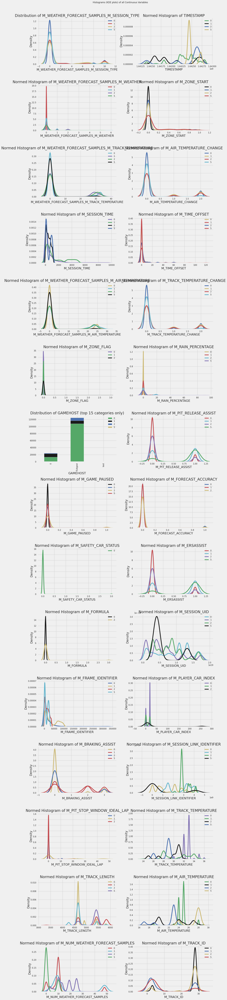

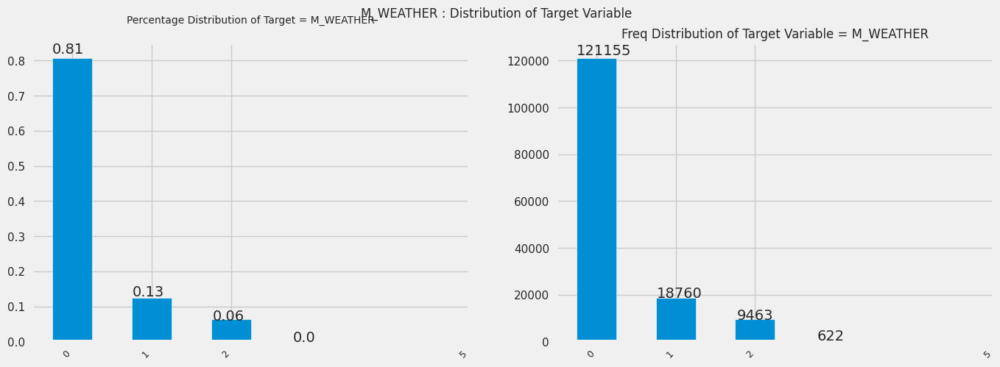

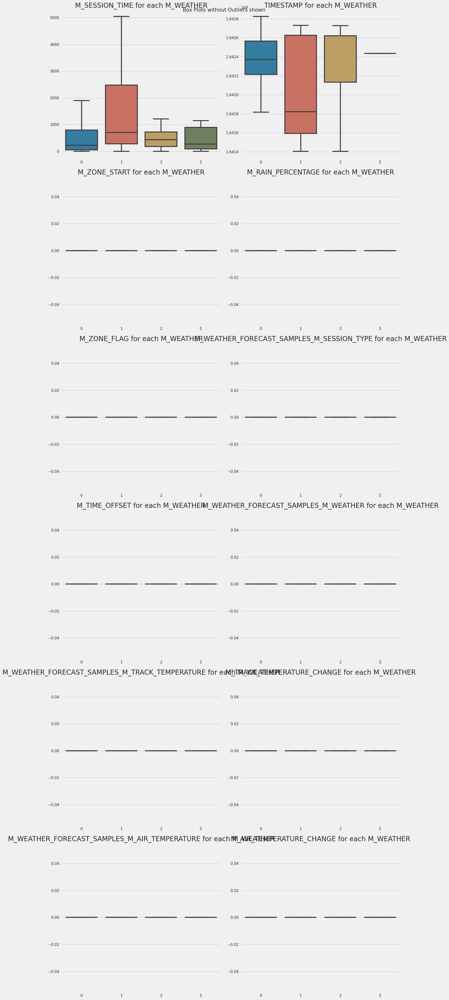

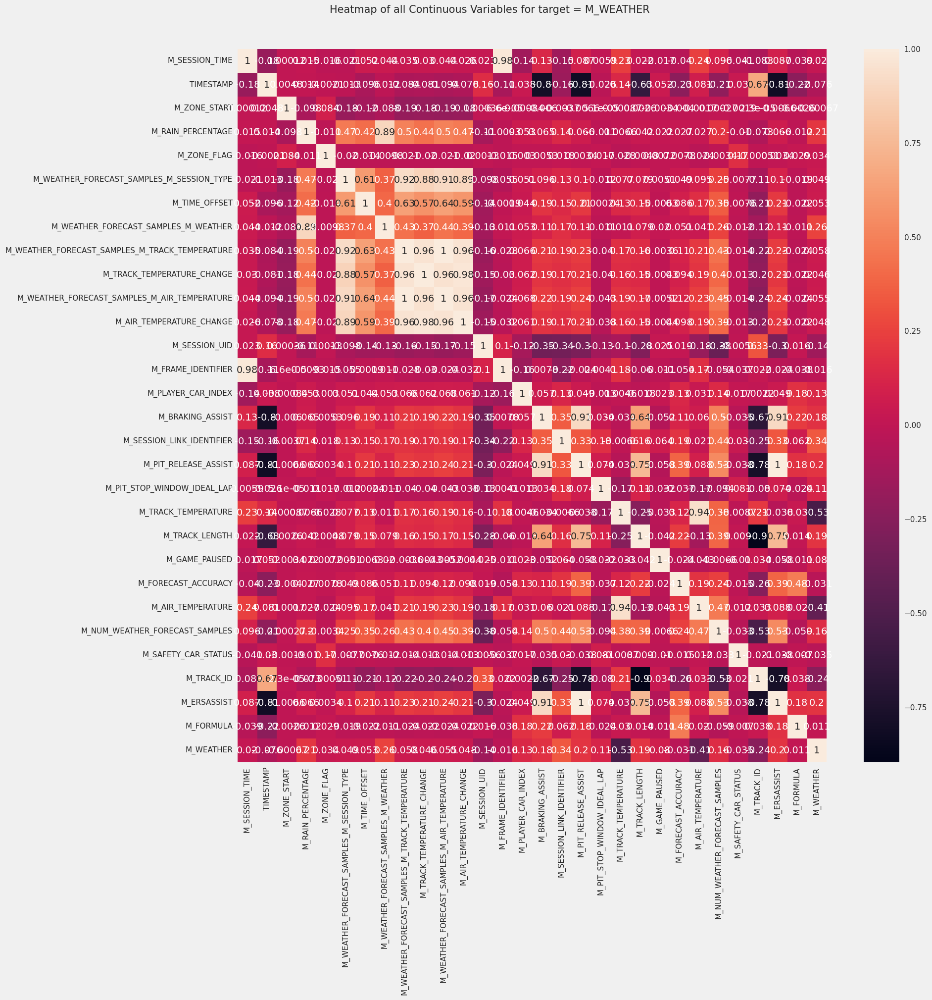

<Figure size 2000x38750 with 0 Axes>

In [15]:
from autoviz.AutoViz_Class import AutoViz_Class

AV = AutoViz_Class()
dftc = AV.AutoViz(
    filename='', 
    sep='' , 
    depVar='M_WEATHER', 
    dfte=data_test, 
    header=0, 
    verbose=1, 
    lowess=False, 
    chart_format='png'
)